In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data= pd.read_csv('https://raw.githubusercontent.com/Shreyas3108/house-price-prediction/master/kc_house_data.csv')
data

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,20140521T000000,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,20150223T000000,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,20140623T000000,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,20150116T000000,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


In [23]:
print("My DataFrame shape is : ", data.shape)

My DataFrame shape is :  (21613, 21)


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [33]:
data.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15', 'predict_price'],
      dtype='object')

In [4]:
# Compter les valeurs manquantes
print(data.isnull().sum())

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64


In [5]:
from datetime import datetime
data["date"]=pd.to_datetime(data["date"])

In [9]:
data.corr()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.000000,-0.016762,0.001286,0.005160,-0.012258,-0.132109,0.018525,-0.002721,0.011592,-0.023783,0.008130,-0.010842,-0.005151,0.021380,-0.016907,-0.008224,-0.001891,0.020799,-0.002901,-0.138798
price,-0.016762,1.000000,0.308350,0.525138,0.702035,0.089661,0.256794,0.266369,0.397293,0.036362,0.667434,0.605567,0.323816,0.054012,0.126434,-0.053203,0.307003,0.021626,0.585379,0.082447
bedrooms,0.001286,0.308350,1.000000,0.515884,0.576671,0.031703,0.175429,-0.006582,0.079532,0.028472,0.356967,0.477600,0.303093,0.154178,0.018841,-0.152668,-0.008931,0.129473,0.391638,0.029244
bathrooms,0.005160,0.525138,0.515884,1.000000,0.754665,0.087740,0.500653,0.063744,0.187737,-0.124982,0.664983,0.685342,0.283770,0.506019,0.050739,-0.203866,0.024573,0.223042,0.568634,0.087175
sqft_living,-0.012258,0.702035,0.576671,0.754665,1.000000,0.172826,0.353949,0.103818,0.284611,-0.058753,0.762704,0.876597,0.435043,0.318049,0.055363,-0.199430,0.052529,0.240223,0.756420,0.183286
sqft_lot,-0.132109,0.089661,0.031703,0.087740,0.172826,1.000000,-0.005201,0.021604,0.074710,-0.008958,0.113621,0.183512,0.015286,0.053080,0.007644,-0.129574,-0.085683,0.229521,0.144608,0.718557
floors,0.018525,0.256794,0.175429,0.500653,0.353949,-0.005201,1.000000,0.023698,0.029444,-0.263768,0.458183,0.523885,-0.245705,0.489319,0.006338,-0.059121,0.049614,0.125419,0.279885,-0.011269
waterfront,-0.002721,0.266369,-0.006582,0.063744,0.103818,0.021604,0.023698,1.000000,0.401857,0.016653,0.082775,0.072075,0.080588,-0.026161,0.092885,0.030285,-0.014274,-0.041910,0.086463,0.030703
view,0.011592,0.397293,0.079532,0.187737,0.284611,0.074710,0.029444,0.401857,1.000000,0.045990,0.251321,0.167649,0.276947,-0.053440,0.103917,0.084827,0.006157,-0.078400,0.280439,0.072575
condition,-0.023783,0.036362,0.028472,-0.124982,-0.058753,-0.008958,-0.263768,0.016653,0.045990,1.000000,-0.144674,-0.158214,0.174105,-0.361417,-0.060618,0.003026,-0.014941,-0.106500,-0.092824,-0.003406


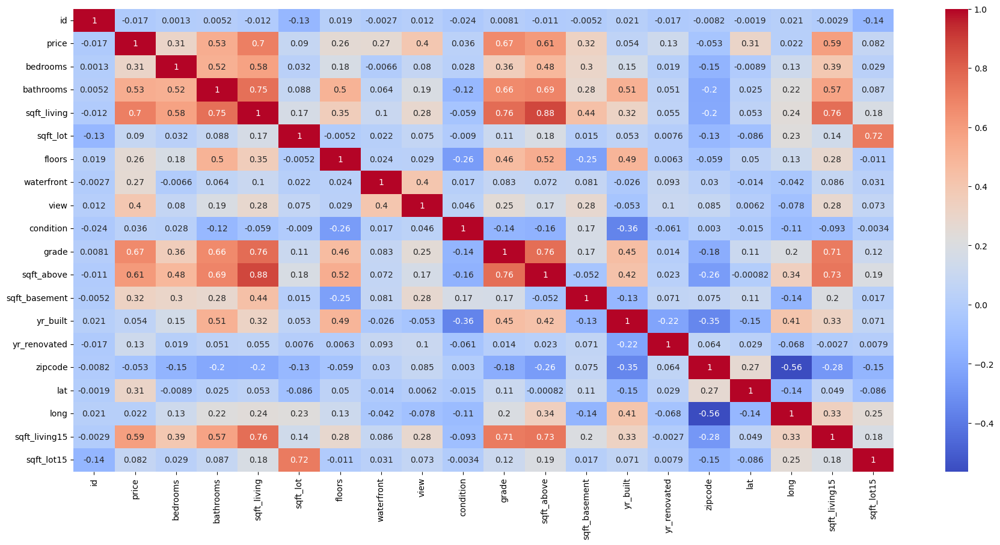

In [17]:
# Exemple : Matrice de corrélation avec Seaborn
plt.figure(figsize=(22,10))
sns.heatmap(data.corr(), annot=True, cmap='coolwarm')
plt.show()

In [18]:
from pandas_profiling import ProfileReport

C:\Users\ziedj\AppData\Local\Temp\ipykernel_11724\2274191625.py:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [19]:
import ydata_profiling

In [21]:
profile = ProfileReport(data)

In [22]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
"""from sklearn.linear_model import LinearRegression

X = df_house1[["grade"]]

y = data['price']


# We train a "model" with "fit" function. This model will store coefficients after training.

model = LinearRegression().fit(X, y)"""

In [34]:

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor



# Sélectionner toutes les colonnes sauf les deux que vous voulez supprimer
X = data.drop(['id', 'date','price'], axis=1)

# Sélectionner la variable dépendante (y)
y = data['price']

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Créer le modèle de régression linéaire
model = LinearRegression()

# Entraîner le modèle sur les données d'entraînement
model.fit(X_train, y_train)

# Faire des prédictions sur les données de test
y_pred = model.predict(X_test)

# Évaluer les performances du modèle
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error : {mse}')


Mean Squared Error : 45173046132.79016


In [26]:
print("\nScore for the Train dataset :", model.score(X_train, y_train))
print("Score for the Test dataset :", model.score(X_test, y_test))


Score for the Train dataset : 0.6991021854487472
Score for the Test dataset : 0.7011904448878257


In [35]:
# Créer le modèle de régression linéaire
modelR = RandomForestRegressor()

# Entraîner le modèle sur les données d'entraînement
modelR.fit(X_train, y_train)

# Faire des prédictions sur les données de test
y_predR = modelR.predict(X_test)

# Évaluer les performances du modèle
mse = mean_squared_error(y_test, y_predR)
print(f'Mean Squared Error_Random : {mse}')

Mean Squared Error_Random : 24170944436.83674


In [36]:
print("\nScore for the Train dataset_random :", modelR.score(X_train, y_train))
print("Score for the Test dataset_random :", modelR.score(X_test, y_test))


Score for the Train dataset_random : 0.984697447737578
Score for the Test dataset_random : 0.8401146309110815


In [37]:
data['predict_price_random']=modelR.predict(X)

In [42]:
data['predict_price_lr']=model.predict(X)

In [43]:
data

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,predict_price,predict_price_random,predict_pricelr,predict_price_lr
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,0,98178,47.5112,-122.257,1340,5650,210969.640312,226405.33,210969.640312,210969.640312
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,1991,98125,47.7210,-122.319,1690,7639,734786.979663,520160.97,734786.979663,734786.979663
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,0,98028,47.7379,-122.233,2720,8062,378458.501736,222807.44,378458.501736,378458.501736
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,0,98136,47.5208,-122.393,1360,5000,455379.996892,473612.38,455379.996892,455379.996892
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,0,98074,47.6168,-122.045,1800,7503,442323.835809,508355.00,442323.835809,442323.835809
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,2014-05-21,360000.0,3,2.50,1530,1131,3.0,0,0,...,0,98103,47.6993,-122.346,1530,1509,480109.761548,409915.55,480109.761548,480109.761548
21609,6600060120,2015-02-23,400000.0,4,2.50,2310,5813,2.0,0,0,...,0,98146,47.5107,-122.362,1830,7200,436910.320232,413413.78,436910.320232,436910.320232
21610,1523300141,2014-06-23,402101.0,2,0.75,1020,1350,2.0,0,0,...,0,98144,47.5944,-122.299,1020,2007,138309.494219,369345.42,138309.494219,138309.494219
21611,291310100,2015-01-16,400000.0,3,2.50,1600,2388,2.0,0,0,...,0,98027,47.5345,-122.069,1410,1287,386536.910437,419608.80,386536.910437,386536.910437


In [45]:
df=data[['price','predict_price_lr','predict_price_random']]
df

,price,predict_price_lr,predict_price_random
0,221900.0,210969.640312,226405.33
1,538000.0,734786.979663,520160.97
2,180000.0,378458.501736,222807.44
3,604000.0,455379.996892,473612.38
4,510000.0,442323.835809,508355.00
...,...,...,...
21608,360000.0,480109.761548,409915.55
21609,400000.0,436910.320232,413413.78
21610,402101.0,138309.494219,369345.42
21611,400000.0,386536.910437,419608.80


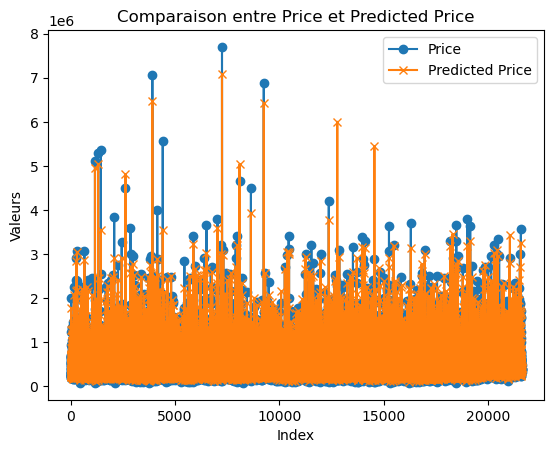

In [46]:
# Afficher un graphique de comparaison
plt.plot(df['price'], label='Price', marker='o')
plt.plot(df['predict_price_random'], label='Predicted Price', marker='x')

# Ajouter des titres et des légendes
plt.title('Comparaison entre Price et Predicted Price')
plt.xlabel('Index')
plt.ylabel('Valeurs')
plt.legend()

# Afficher le graphiqu

In [ ]:
# Afficher un graphique de comparaison
plt.plot(df['price'], label='Price', marker='o')
plt.plot(df['predict_price'], label='Predicted Price', marker='x')

# Ajouter des titres et des légendes
plt.title('Comparaison entre Price et Predicted Price')
plt.xlabel('Index')
plt.ylabel('Valeurs')
plt.legend()

In [ ]:
import streamlit as st
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
https://github.com/AmandineRolland/The-stonewall-rangers/blob/main/stonewall_rangers.py
https://github.com/AmandineRolland/The-stonewall-rangers/blob/main/stonewall_rangers.py

In [ ]:
# Sélectionner toutes les colonnes sauf les deux que vous voulez supprimer
X = data.drop(['id', 'date','price'], axis=1)

# Sélectionner la variable dépendante (y)
y = data['price']

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Créer le modèle de régression linéaire
model = LinearRegression()

# Entraîner le modèle sur les données d'entraînement
model.fit(X_train, y_train)

# Faire des prédictions sur les données de test
y_pred = model.predict(X_test)

st.title(" Prediction using Linear Regression")

st.text(" ")
st.text(" ")
st.text(" ")

#st.image('stockindex.jpeg',width=700)

st.text(" ")
st.text(" ")
st.text(" ")
st.text(" ")
st.text(" ")
st.text(" ")

st.subheader("Relationship between Stock Index Price and Economic Growth Rate")

st.text(" ")
st.text(" ")
st.text(" ")

plt.figure(figsize=(9,6))
plt.xlabel("Economic Growth Rate")
plt.ylabel("Stock Index Price")
plt.scatter(df['EconomicGrowth_Rate'],df['Stock_Index_Price'],color='g')
plt.tight_layout()
st.set_option('deprecation.showPyplotGlobalUse',False)
st.pyplot()


st.text(" ")
st.text(" ")
st.text(" ")
st.text(" ")
st.text(" ")
st.text(" ")

st.subheader("Relationship between Stock Index Price and unemployment Rate")

st.text(" ")
st.text(" ")
st.text(" ")

plt.figure(figsize=(9,6))
plt.xlabel("Unemployment Rate")
plt.ylabel("Stock Index Price")
plt.scatter(df['Unemployment_Rate'],df['Stock_Index_Price'],color='g')
plt.tight_layout()
st.set_option('deprecation.showPyplotGlobalUse',False)
st.pyplot()

st.text(" ")
st.text(" ")
st.text(" ")

i = st.number_input("Enter Economic Growth Rate")
st.text(" ")
st.text(" ")
u = st.number_input("Enter Unemployment Rate")
st.text(" ")
st.text(" ")

if st.button("Predict"):
    st.subheader("Predicted Value of Stock Index")
    st.text(model.predict([['bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15']]))